<a href="https://colab.research.google.com/github/9-coding/Computer_Vision/blob/main/Assignment2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [44]:
from google.colab import drive
drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [45]:
file_path = '/content/gdrive/MyDrive/Colab Notebooks/Computer_Vision/Lab02'

# Quiz

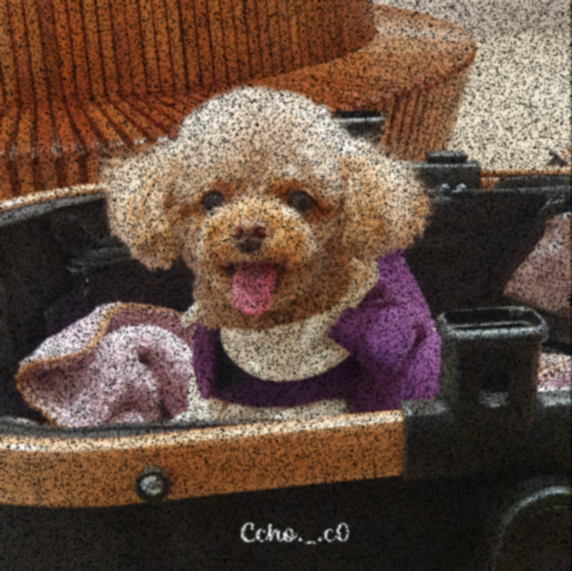

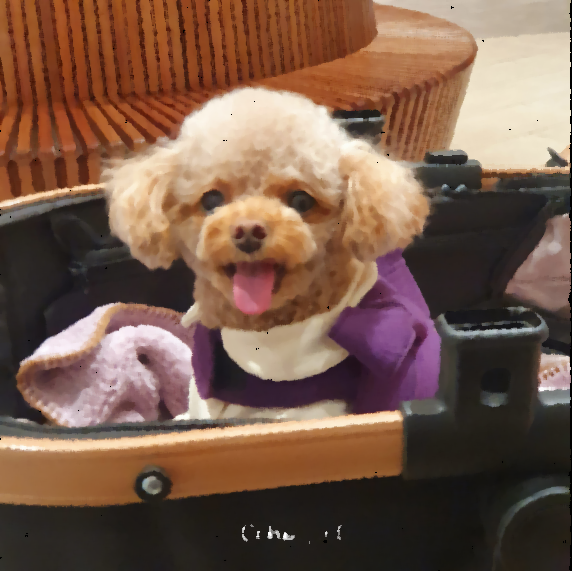

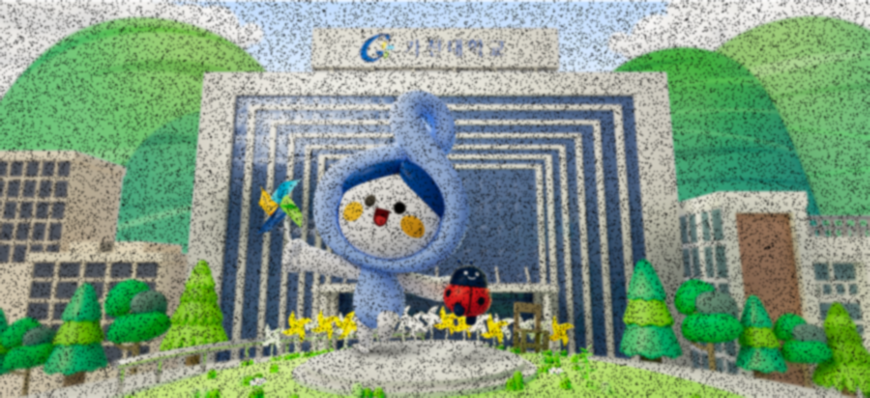

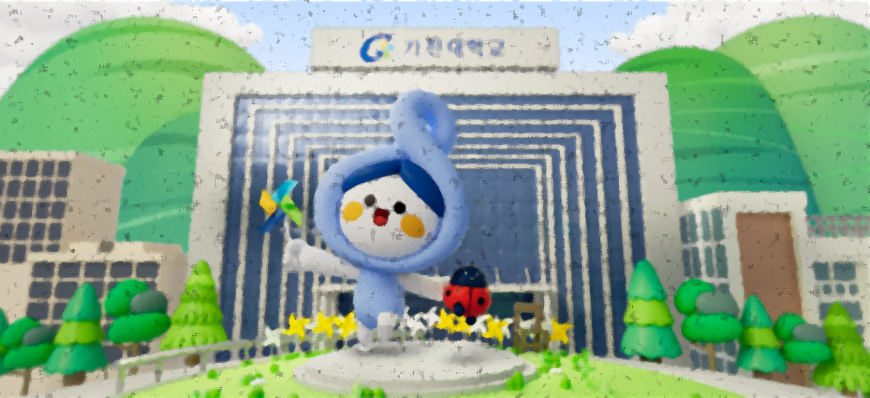

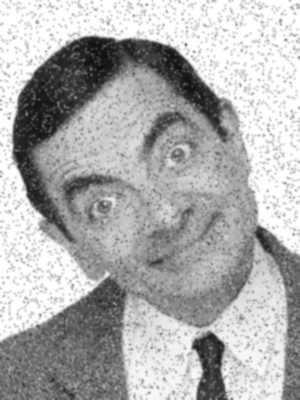

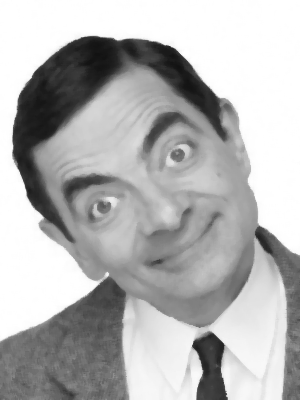

In [46]:
import cv2 as cv
import numpy as np
import sys
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow


def denoising(img):
  if img is None:
    sys.exit('File Not Found')

  dst1 = cv.GaussianBlur(img, (5,5),1)
  dst2 = cv.medianBlur(img, 5, 1)

  cv2_imshow(dst1)
  cv2_imshow(dst2)

img1 = cv.imread(file_path + '/image_set/noise_quiz1.png')
denoising(img1)
img2 = cv.imread(file_path + '/image_set/noise_quiz2.png')
denoising(img2)
img3 = cv.imread(file_path + '/image_set/noise_quiz3.png')
denoising(img3)

# Lab02-3 Image Gradients

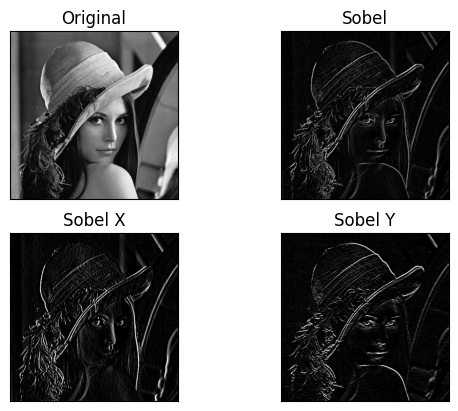

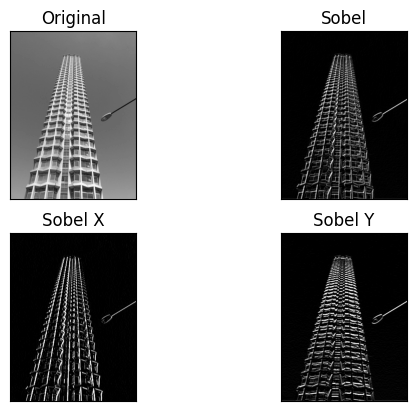

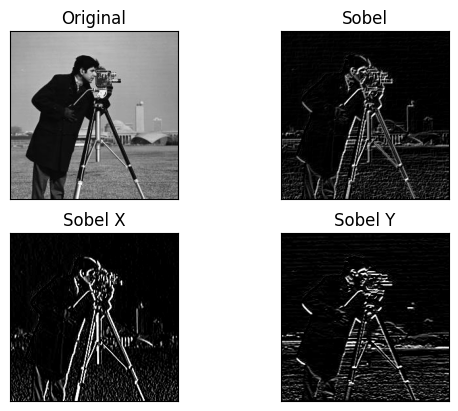

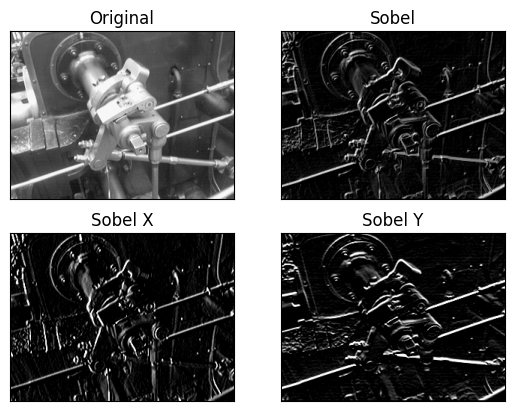

In [47]:
import cv2 as cv
import numpy as np
import sys
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow

def sobel(img):
  if img is None:
    sys.exit('File Not Found')

  # src, ddepth, dx, dy, ksize
  sobelx = cv.Sobel(img, -1,1,0,3)
  sobely = cv.Sobel(img, -1,0,1,3)

  abs_grad_x = cv.convertScaleAbs(sobelx)
  abs_grad_y = cv.convertScaleAbs(sobely)
  sobel = cv.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)

  plt.subplot(2,2,1),plt.imshow(img,cmap='gray')
  plt.title('Original'),plt.xticks([]), plt.yticks([])
  plt.subplot(2,2,2),plt.imshow(sobel,cmap='gray')
  plt.title('Sobel'),plt.xticks([]), plt.yticks([])
  plt.subplot(2,2,3),plt.imshow(sobelx,cmap='gray')
  plt.title('Sobel X'),plt.xticks([]), plt.yticks([])
  plt.subplot(2,2,4),plt.imshow(sobely,cmap='gray')
  plt.title('Sobel Y'),plt.xticks([]), plt.yticks([])

  plt.show()


img1=cv.imread(file_path + '/image_set/lena_gray.png', 0)
sobel(img1)

img2=cv.imread(file_path + '/image_set/edge1.png', 0)
sobel(img2)

img3=cv.imread(file_path + '/image_set/edge2.png', 0)
sobel(img3)

img4=cv.imread(file_path + '/image_set/edge3.png', 0)
sobel(img4)

cv.waitKey()
cv.destroyAllWindows()


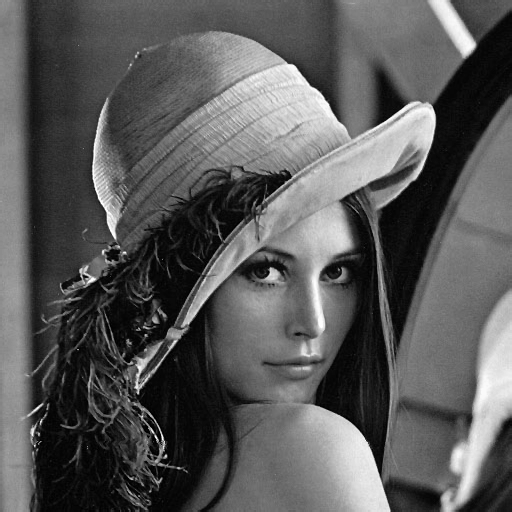

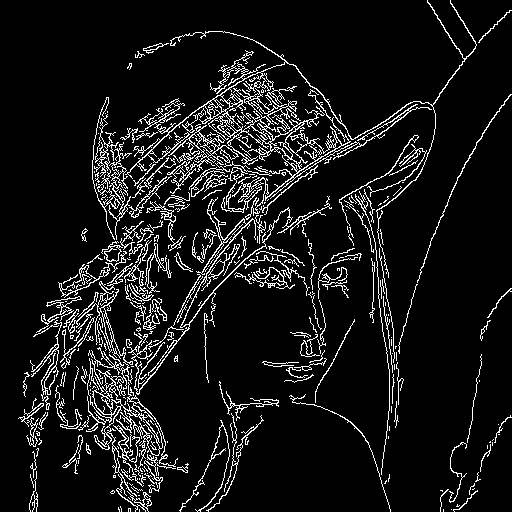

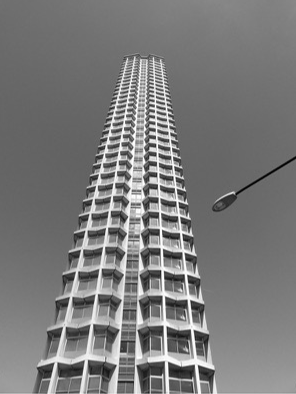

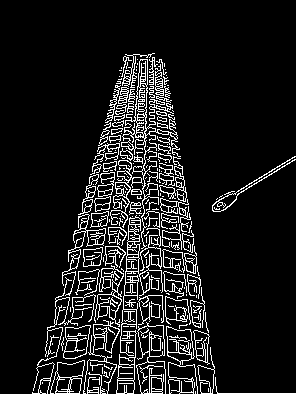

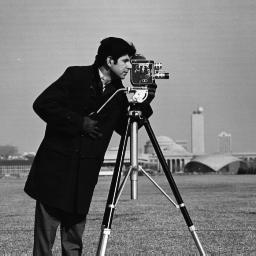

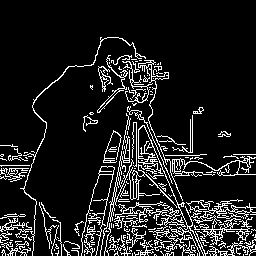

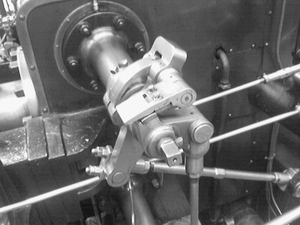

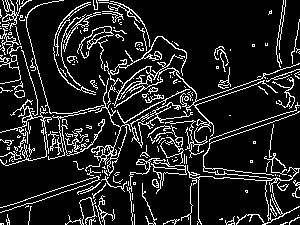

In [48]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow

def Canny_func(img, th1, th2):
  canny_img = cv.Canny(img, th1, th2)

  cv2_imshow(img)
  cv2_imshow(canny_img)

threshold1 = 50
threshold2 = 200
img1=cv.imread(file_path + '/image_set/lena_gray.png', 0)
Canny_func(img1, threshold1, threshold2)

img2=cv.imread(file_path + '/image_set/edge1.png', 0)
Canny_func(img2, threshold1, threshold2)

img3=cv.imread(file_path + '/image_set/edge2.png', 0)
Canny_func(img3, threshold1, threshold2)

img4=cv.imread(file_path + '/image_set/edge3.png', 0)
Canny_func( img4, threshold1, threshold2)

cv.waitKey()
cv.destroyAllWindows()

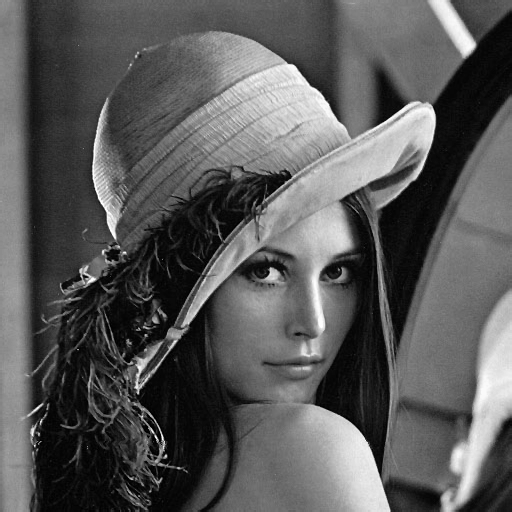

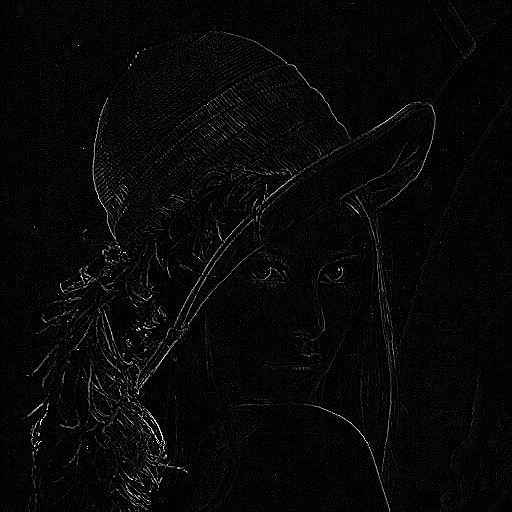

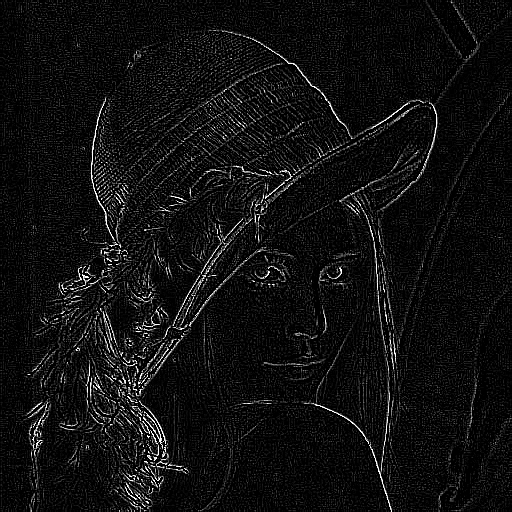

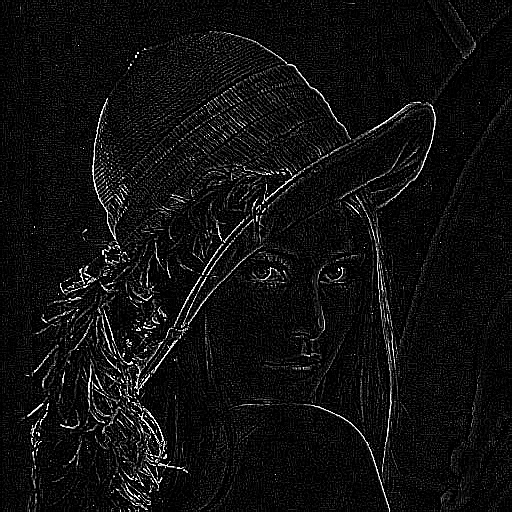

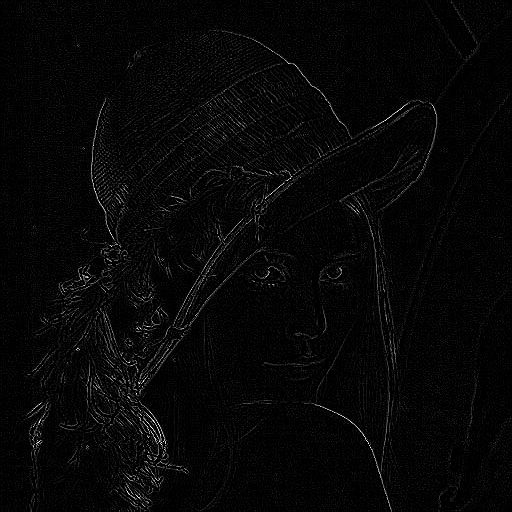

...

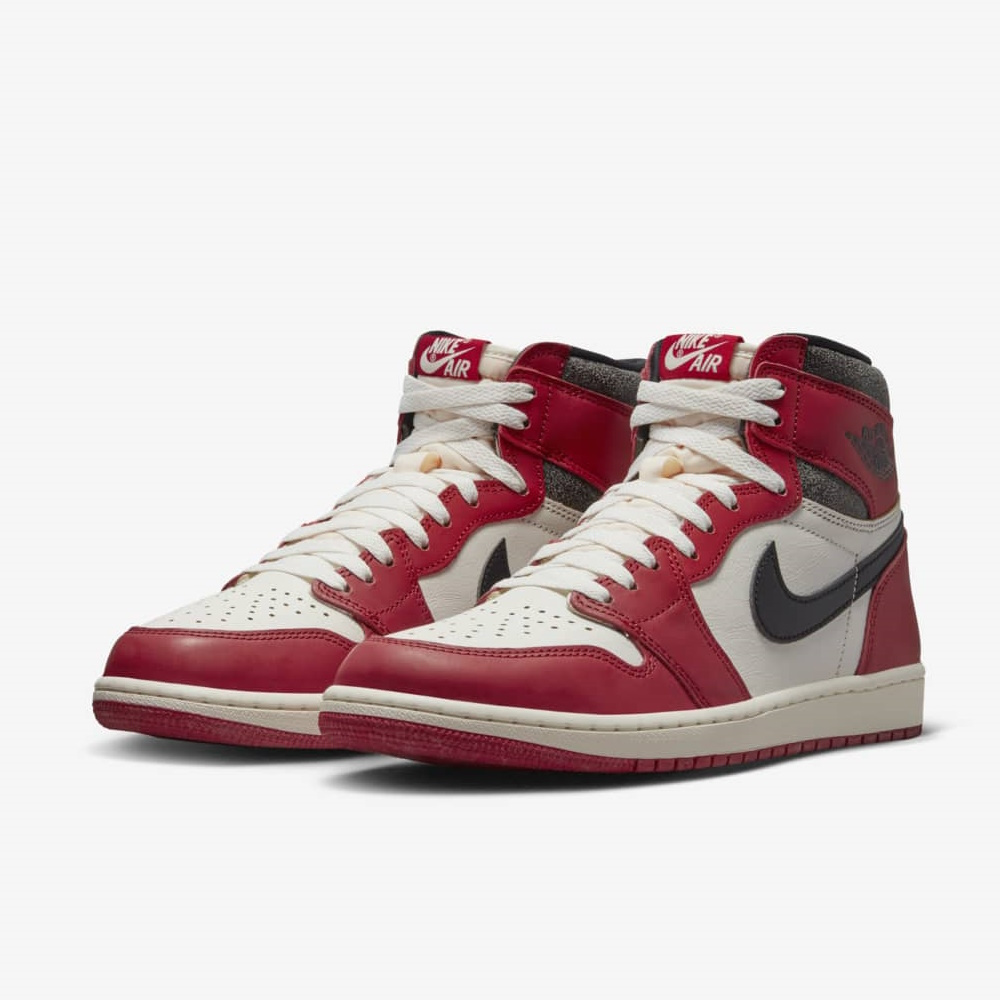

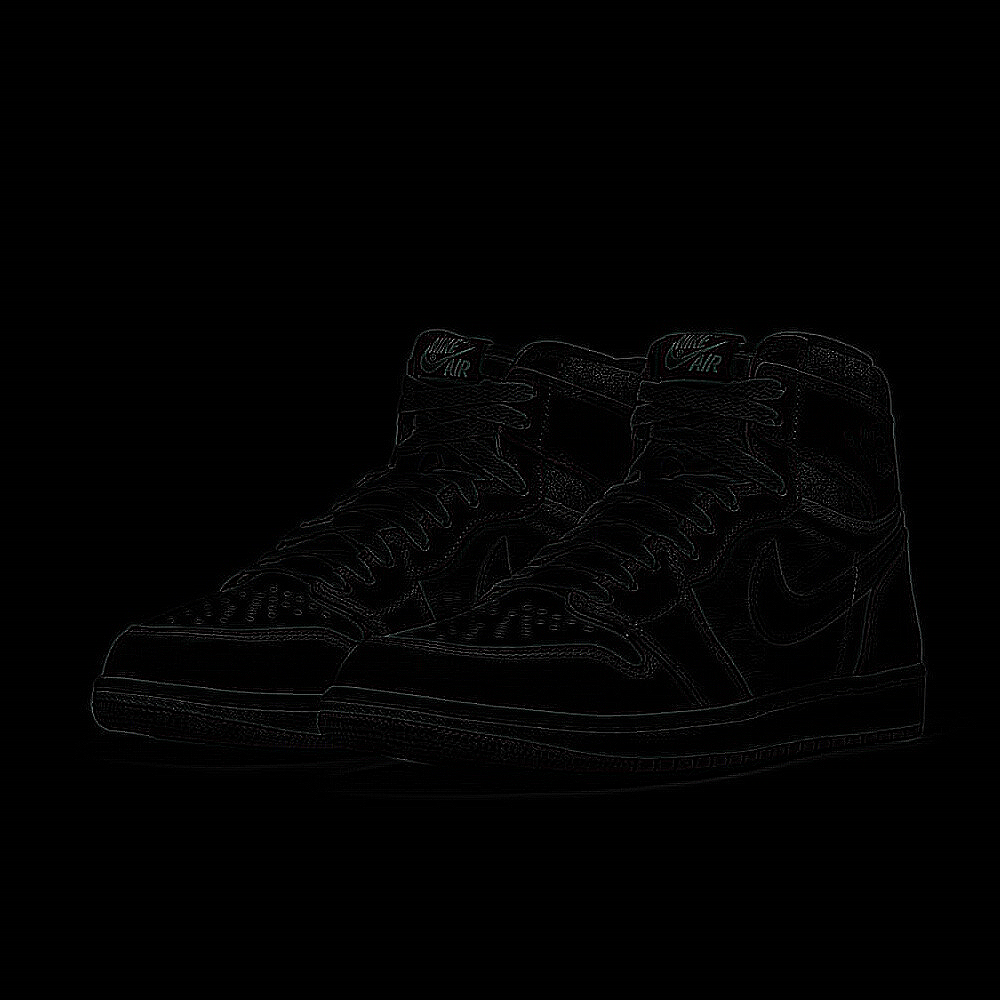

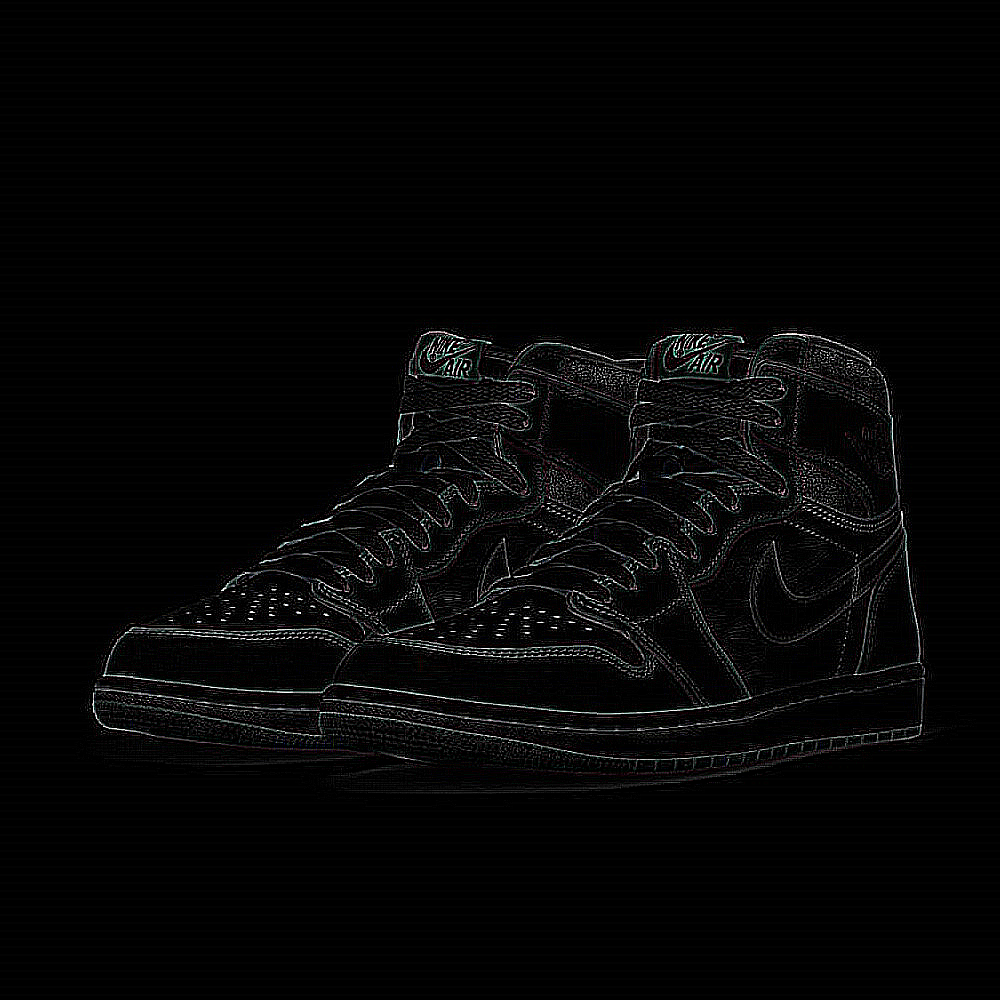

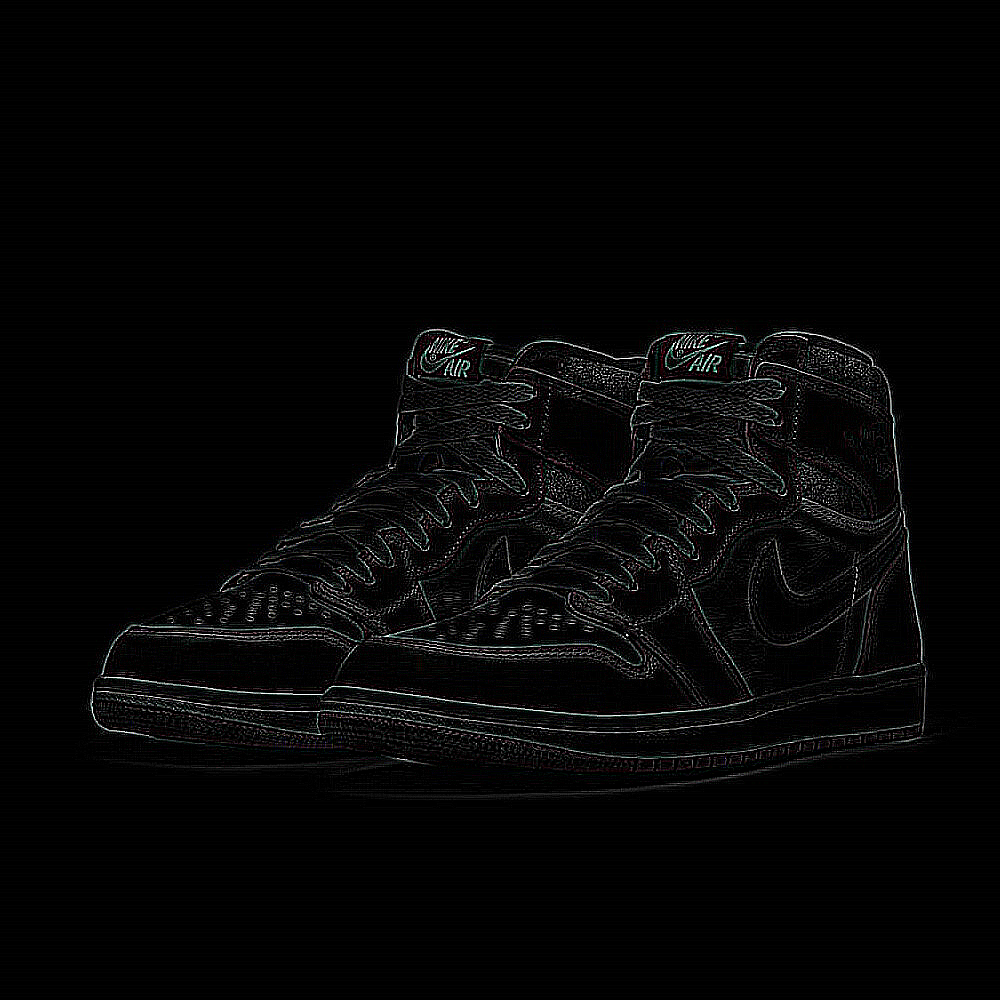

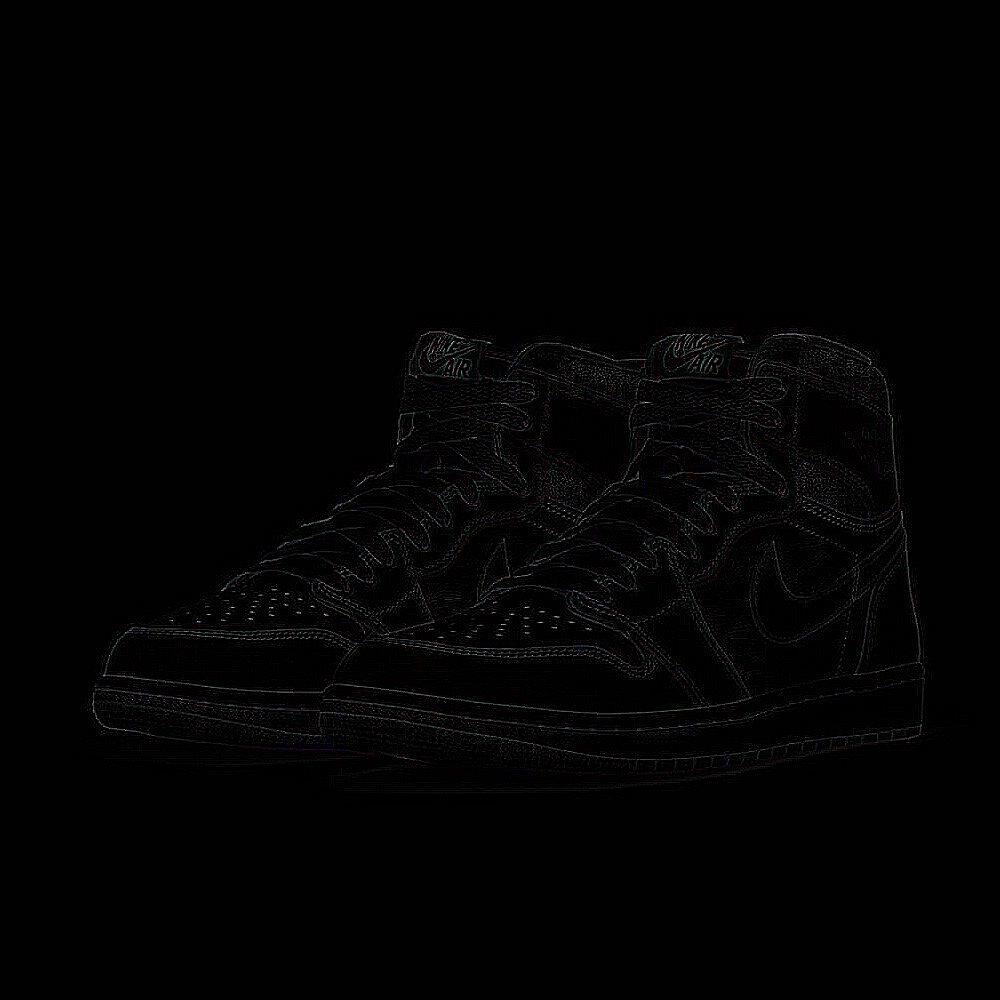

In [50]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

def Laplacian_func(img):
  laplacian = cv.Laplacian(img, cv.CV_8U, ksize=3)

  mask1 = np.array([[0, -1, 0], [-1, 4,-1], [0, -1, 0]])
  mask2 = np.array([[1, 1, 1], [1, -8, 1], [1, 1, 1]])
  mask3 = np.array([[-1, -1, -1], [-1, 8,-1], [-1, -1, -1]])

  laplacian1 = cv.filter2D(img, -1, mask1)
  laplacian2 = cv.filter2D(img, -1, mask2)
  laplacian3 = cv.filter2D(img, -1, mask3)
  laplacian4 = cv.Laplacian(img, -1)

  cv2_imshow(img)
  cv2_imshow(laplacian1)
  cv2_imshow(laplacian2)
  cv2_imshow(laplacian3)
  cv2_imshow(laplacian4)

  cv.waitKey()
  cv.destroyAllWindows()

img1=cv.imread(file_path + '/image_set/lena_gray.png', 0)
Laplacian_func(img1)

img2=cv.imread(file_path + '/image_set/edge1.png', 0)
Laplacian_func(img2)

img3=cv.imread(file_path + '/image_set/edge2.png', 0)
Laplacian_func(img3)

img4=cv.imread(file_path + '/image_set/edge3.png', 0)
Laplacian_func(img4)

img5=cv.imread(file_path + '/sample_image/aj1_high_chicago.jpeg')
Laplacian_func(img5)

# Lab02-4

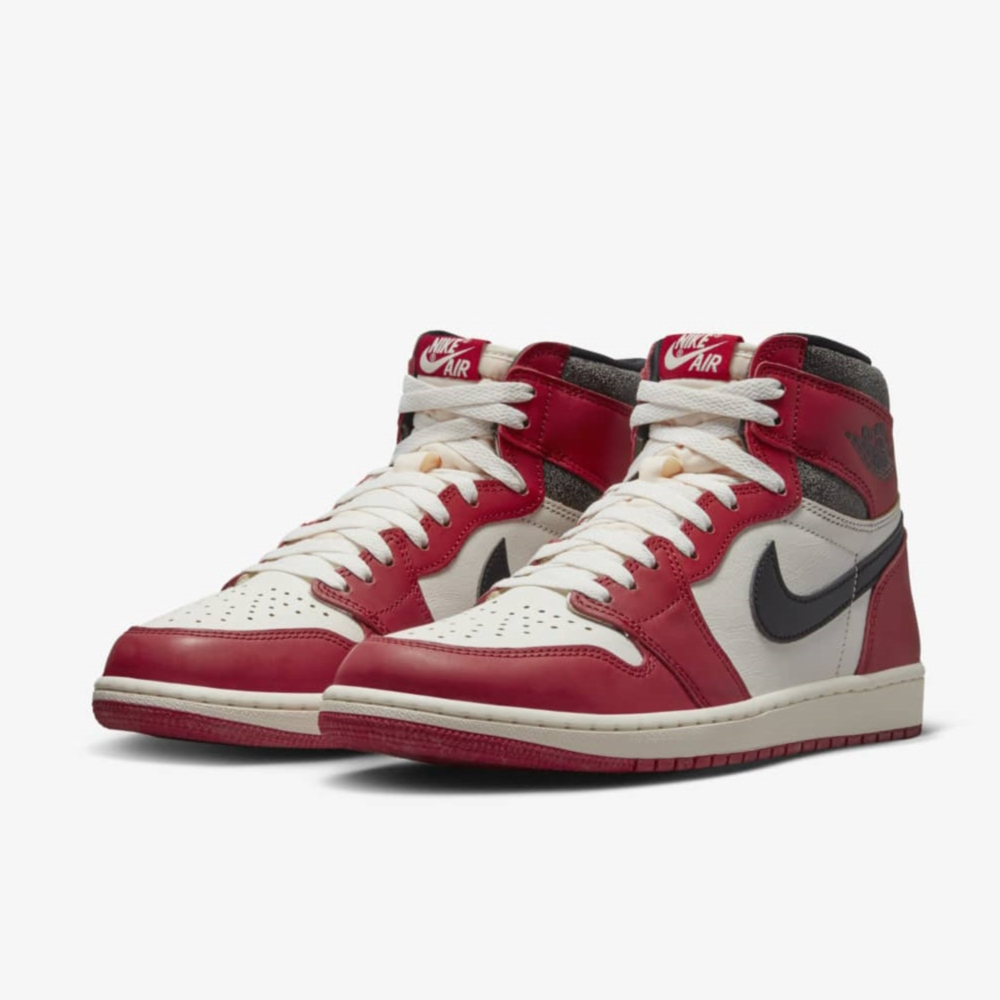

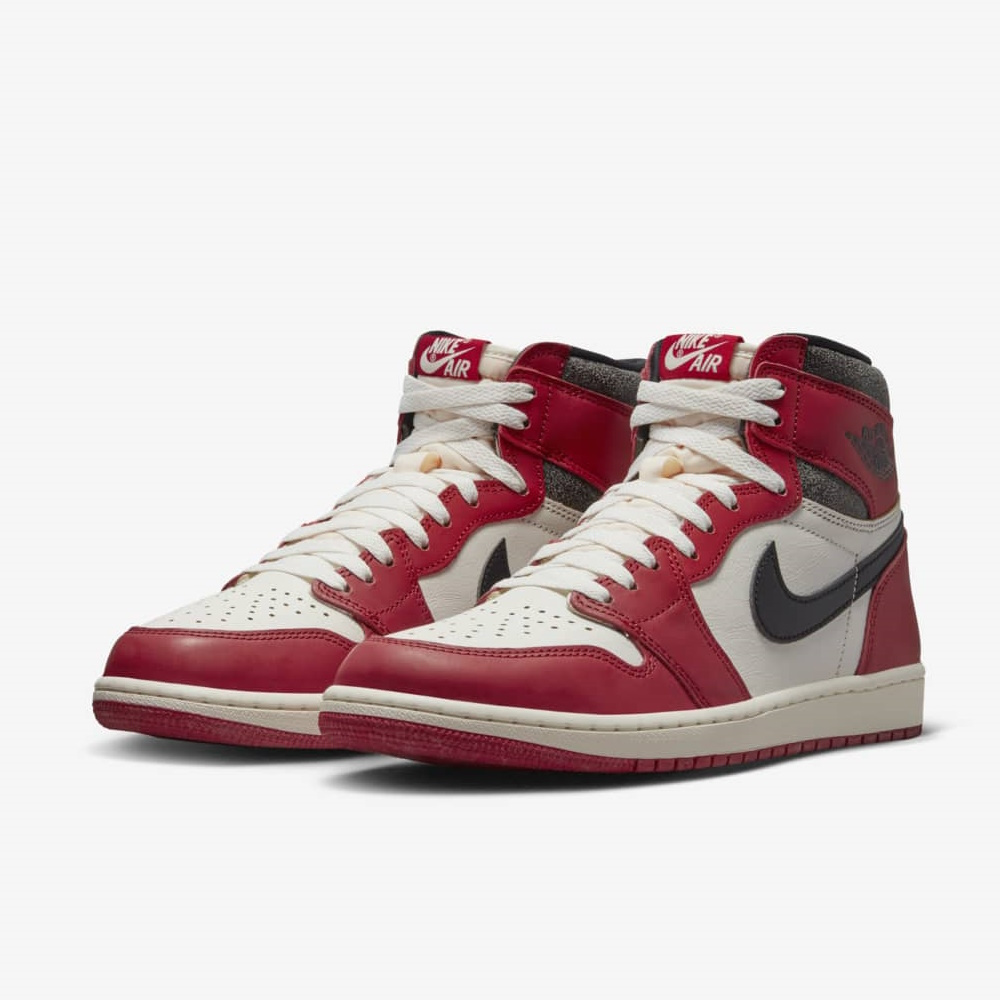

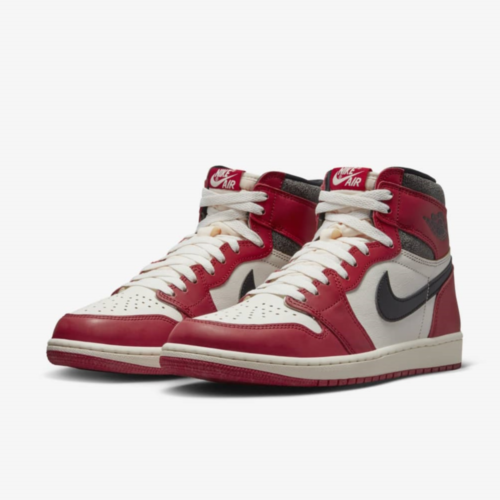

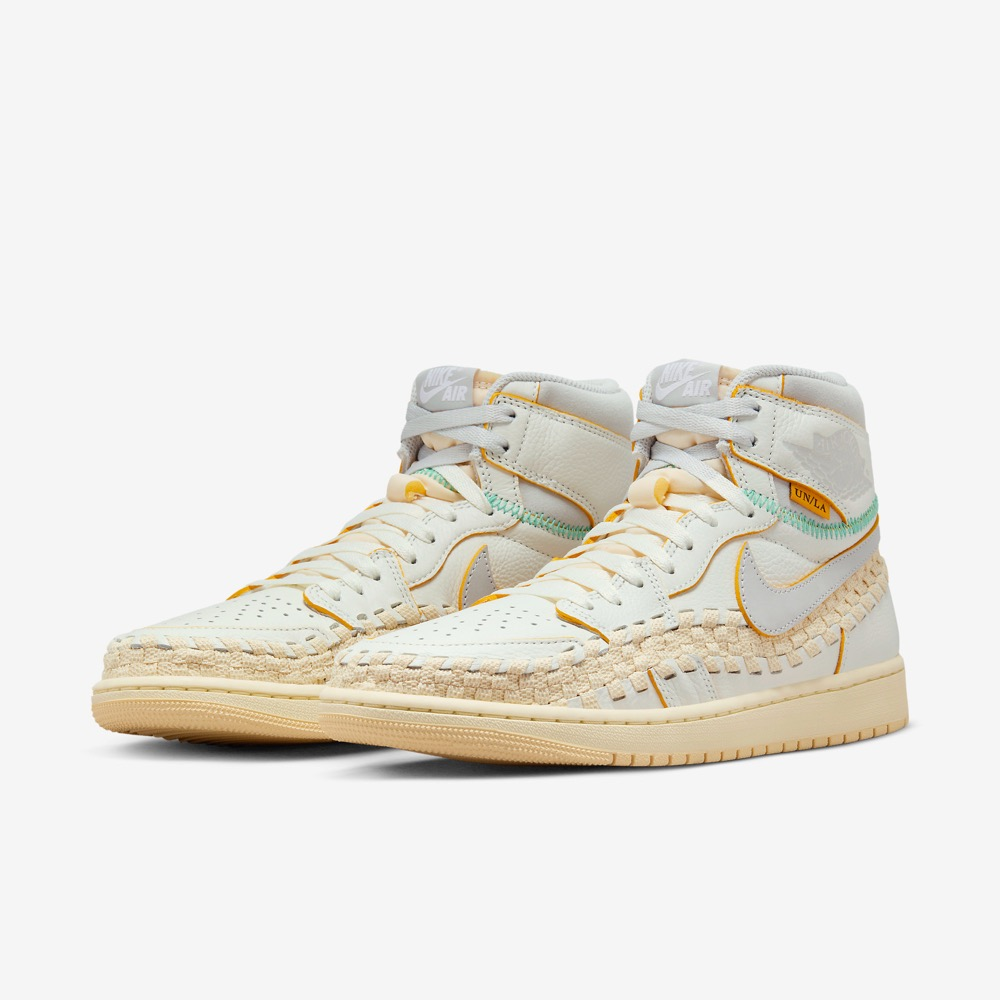

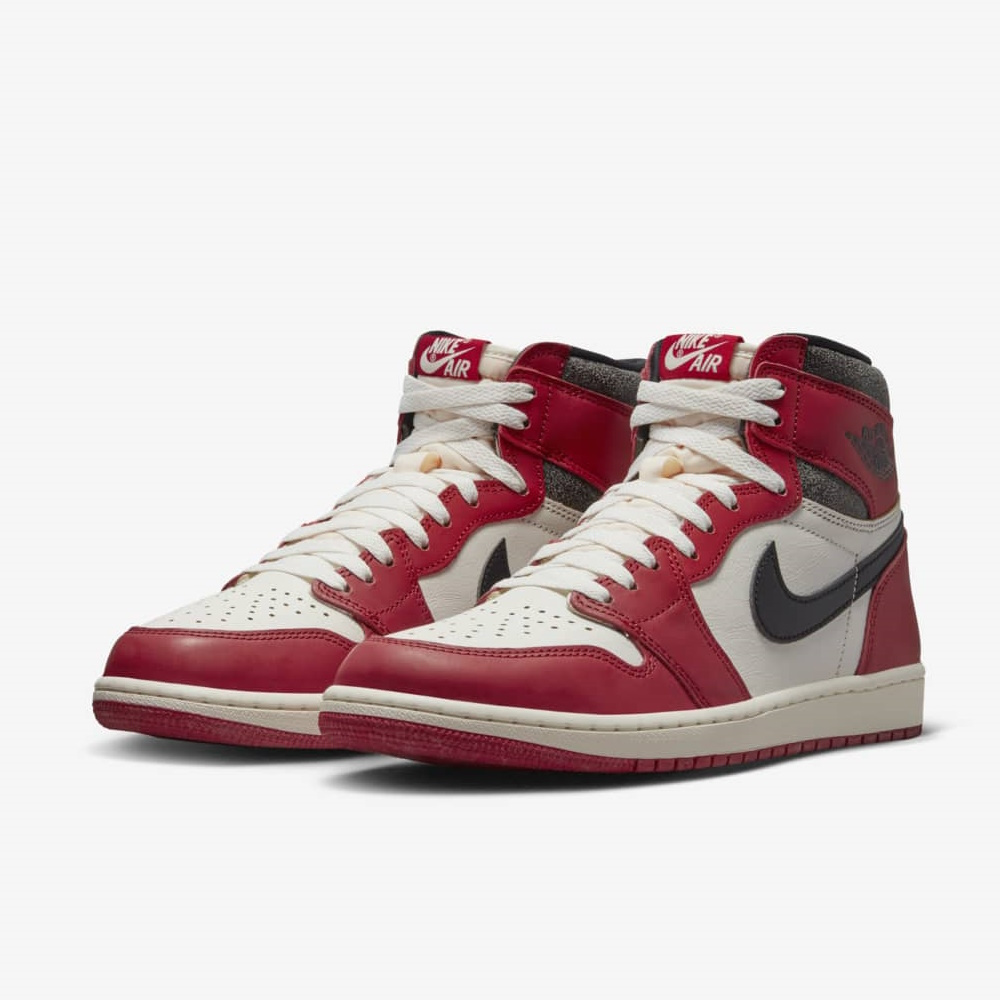

...

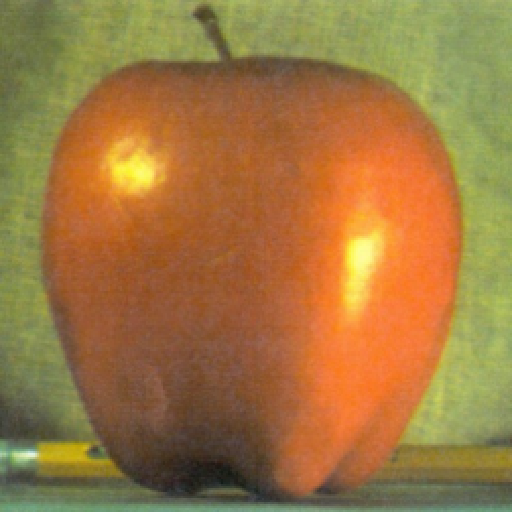

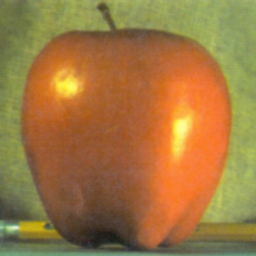

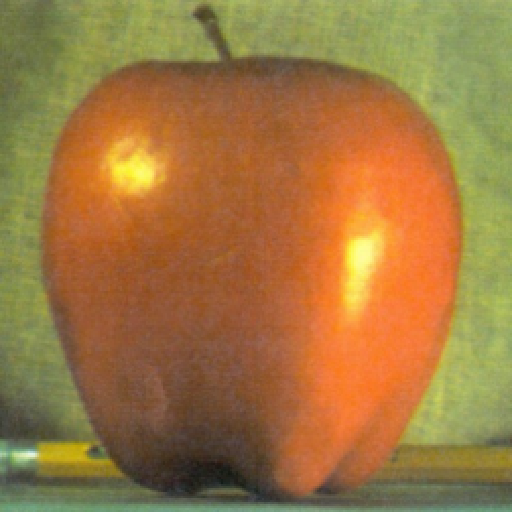

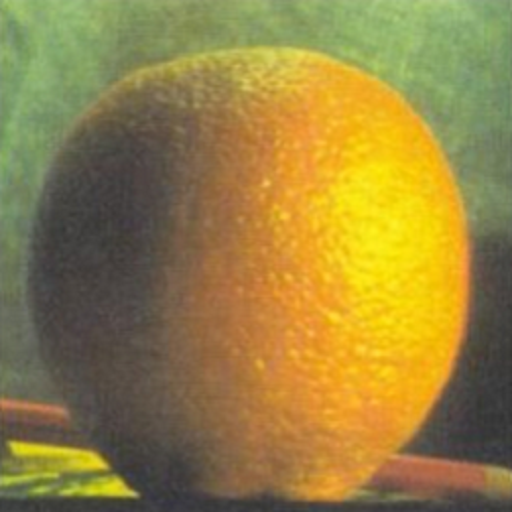

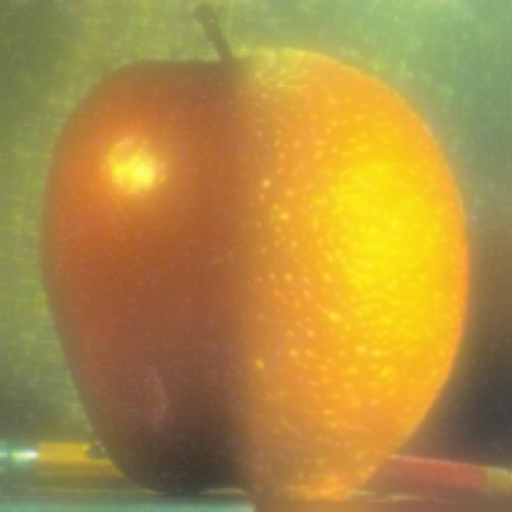

In [53]:
import cv2
import sys
import numpy as np
from google.colab.patches import cv2_imshow

def Image_pyramid(img):
  height, width, channel = img.shape
  dst = cv.pyrDown(img)
  dst2 = cv.pyrUp(img, dstsize=(width*2, height*2), borderType=cv.BORDER_DEFAULT)

  cv2_imshow(dst2)
  cv2_imshow(img)
  cv2_imshow(dst)


def Gaussian_pyramid(img):
  copy = img.copy()
  gp = [copy]
  for i in range(6):
    copy = cv2.pyrDown(copy)
    gp.append(copy)

  return copy, gp

def Laplacian_pyramid(img1_copy, gp_img1, n):
  img1_copy = gp_img1[n]
  lp_img1 = [img1_copy]
  for i in range(n,0,-1):
    gaussian_expanded = cv2.pyrUp(gp_img1[i])
    gaussian_expanded = cv2.resize(gaussian_expanded, (len(gp_img1[i-1][0]), len(gp_img1[i-1][1])))
    laplacian = cv2.subtract(gp_img1[i-1], gaussian_expanded)
    lp_img1.append(laplacian)
  return lp_img1

def Image_blending(img1, img2):
  img1_img2 = np.hstack((img1[:, :500], img2[:,500:]))

  # generate Gaussian pyramid for img1 and img2
  img1_copy, gp_img1 = Gaussian_pyramid(img1)
  img2_copy, gp_img2 = Gaussian_pyramid(img2)

  # generate Laplacian Pyramid for img1
  lp_img1 = Laplacian_pyramid(img1_copy, gp_img1, 5)
  lp_img2 = Laplacian_pyramid(img2_copy, gp_img2, 5)

  # Now add left and right halves of images in each level
  img1_img2_pyramid = []
  n = 0
  for img1_lap, img2_lap in zip(lp_img1, lp_img2):
    n+= 1
    cols, rows, ch = img1_lap.shape
    laplacian = np.hstack((img1_lap[:, 0:int(cols/2)], img2_lap[:, int(cols/2):]))
    img1_img2_pyramid.append(laplacian)

  # now reconstruct
  img1_img2_reconstruct = img1_img2_pyramid[0]
  for i in range(1,6):
    img1_img2_reconstruct = cv2.pyrUp(img1_img2_reconstruct)
    img1_img2_reconstruct = cv2.resize(img1_img2_reconstruct, (len(img1_img2_pyramid[i][0]), len(img1_img2_pyramid[i][1])))
    img1_img2_reconstruct = cv2.add(img1_img2_pyramid[i], img1_img2_reconstruct)

  cv2_imshow(img1)
  cv2_imshow(img2)
  cv2_imshow(img1_img2_reconstruct)


uni = cv2.imread(file_path + '/sample_image/aj1_high_bbs_union.jpg')
chi = cv2.imread(file_path + '/sample_image/aj1_high_chicago.jpeg')
Image_pyramid(chi)
Image_blending(uni, chi)

apple = cv2.imread(file_path + '/image_set/apple.png')
orange = cv2.imread(file_path + '/image_set/orange.png')
Image_pyramid(apple)
Image_blending(apple, orange)

cv2.waitKey()
cv2.destroyAllWindows()


# Lab03-1 Harris Corner Detection

In [63]:
file_path = '/content/gdrive/MyDrive/Colab Notebooks/Computer_Vision/Lab03'

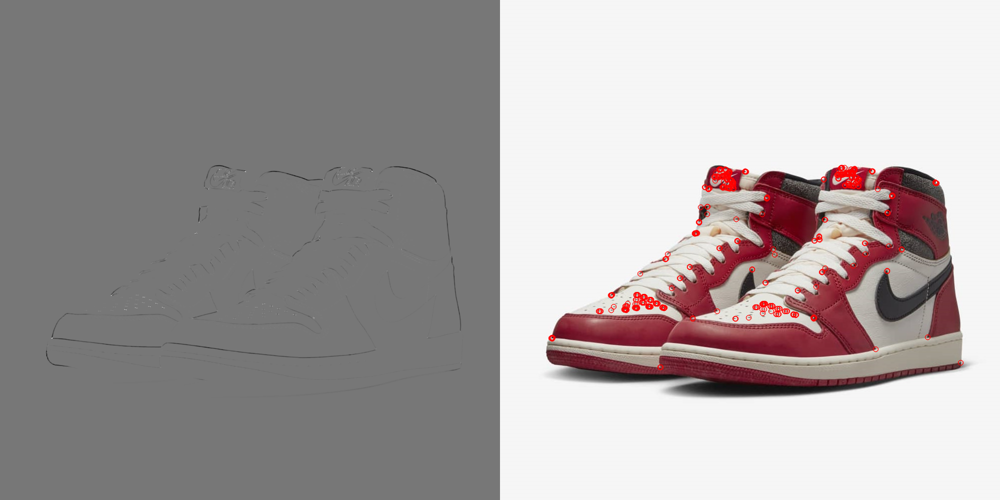

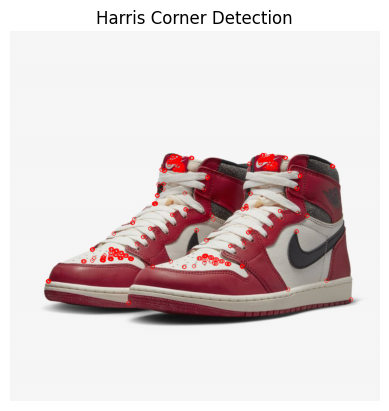

In [68]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(file_path + '/sample_image/aj1_high_chicago.jpeg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Harris Corner Detection
corner = cv2.cornerHarris(gray, 2, 3, 0.04)

# Find coordinates with a maximum value of 10% or more of the change result
coord = np.where(corner > 0.1 * corner.max())
coord = np.stack((coord[1], coord[0]), axis=-1)

# Circle corner coordinates
for x, y in coord:
  cv2.circle(img, (x,y), 5, (0,0,255), 1, cv2.LINE_AA)

# Normalized from 0 to 255 to express the amount of change as an image
corner_norm = cv2.normalize(corner, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

# print
corner_norm = cv2.cvtColor(corner_norm, cv2.COLOR_GRAY2BGR)
merged = np.hstack((corner_norm, img))

cv2_imshow(merged)

cv2.waitKey()
cv2.destroyAllWindows()

# print (matplot)
b, g, r = cv2.split(img)
img_RGB = cv2.merge([r, g, b])
plt.imshow(img_RGB)
plt.axis("off")
plt.title("Harris Corner Detection")
plt.show()


# Lab03-2 SIFT

keypoint: 1993 descriptor: (1993, 128)
[[107.  57.   2. ...   0.   0.   0.]
 [ 51.  33.   8. ...   1.   1.   1.]
 [  1.   0.   1. ...   1.   1.   0.]
 ...
 [  5.   2.   2. ...   0.   2.   8.]
 [  0.  30.  22. ...   0.   0.  12.]
 [  6.   2.   1. ...   0.   1.   4.]]


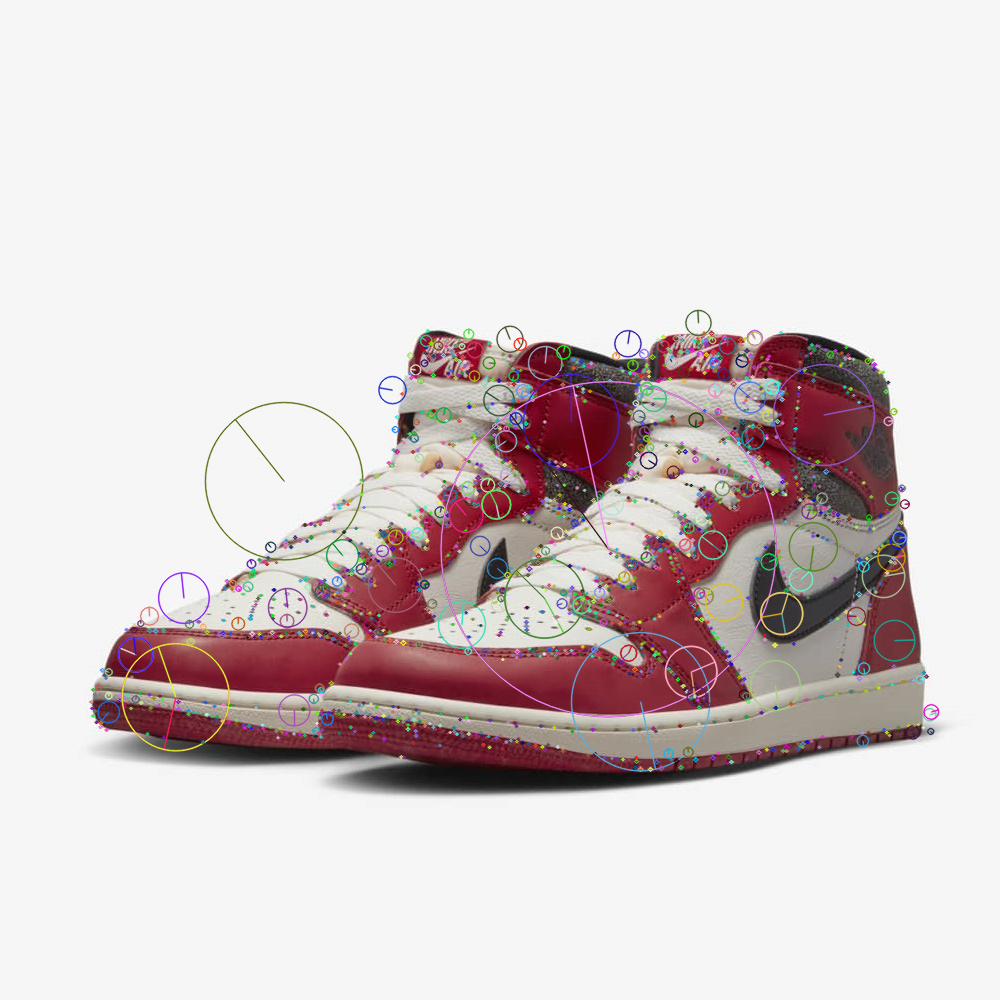

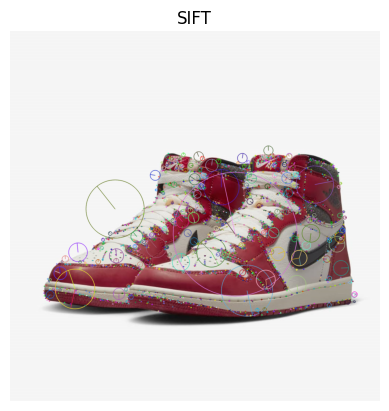

In [69]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(file_path + '/sample_image/aj1_high_chicago.jpeg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

sift = cv2.xfeatures2d.SIFT_create()

keypoints, descriptor = sift.detectAndCompute(gray, None)
print('keypoint:', len(keypoints), 'descriptor:', descriptor.shape)
print(descriptor)

img_draw = cv2.drawKeypoints(img, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# print (cv2)
cv2_imshow(img_draw)
cv2.waitKey()
cv2.destroyAllWindows()

# print (matplot)
b, g, r = cv2.split(img_draw)
img_RGB = cv2.merge([r, g, b])
plt.imshow(img_RGB)
plt.axis("off")
plt.title("SIFT")
plt.show()

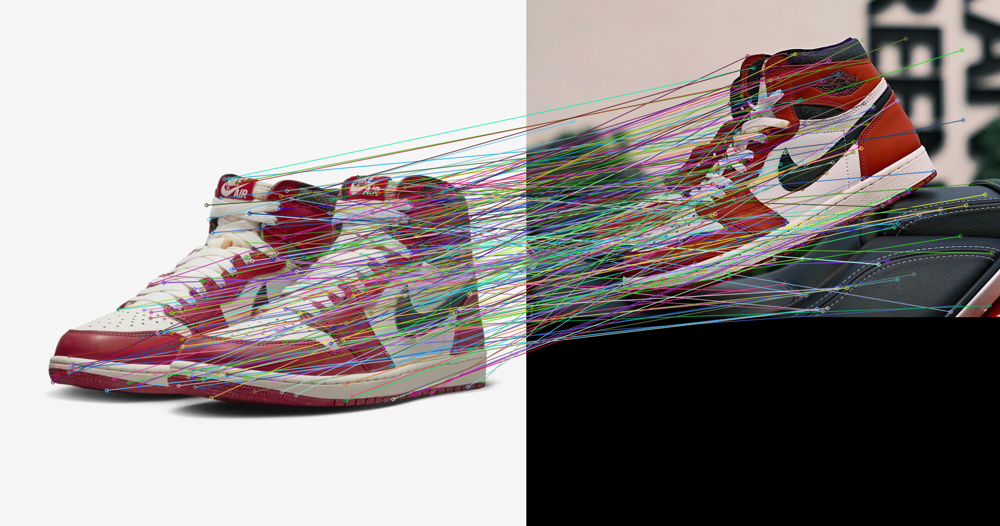

In [71]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

img1 = cv2.imread(file_path + '/sample_image/aj1_high_chicago.jpeg')
img2 = cv2.imread(file_path + '/sample_image/aj1_high_chicago_1.jpeg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

detector = cv2.xfeatures2d.SIFT_create()

kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

matcher = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
matches = matcher.match(desc1, desc2)
res = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

# print (cv2)
cv2_imshow(res)
cv2.waitKey()
cv2.destroyAllWindows()

# Lab03-3 ORB



matches:14/114, min:30.00, max:83.00, thresh:40.60


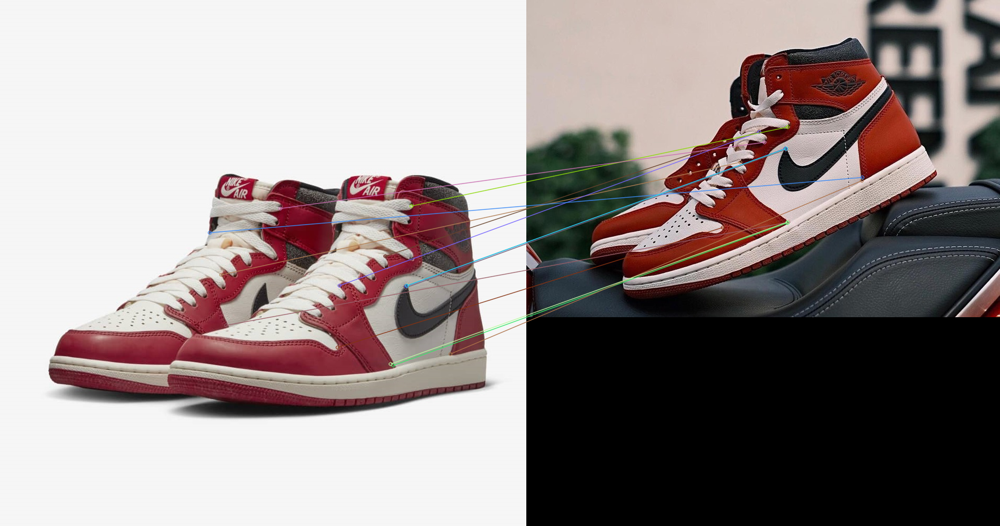

In [75]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img1 = cv2.imread(file_path + '/sample_image/aj1_high_chicago.jpeg')
img2 = cv2.imread(file_path + '/sample_image/aj1_high_chicago_1.jpeg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

detector = cv2.ORB_create()

kp1, desc1 = detector.detectAndCompute(gray1, None)
kp2, desc2 = detector.detectAndCompute(gray2, None)

matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = matcher.match(desc1, desc2)

matches = sorted(matches, key=lambda x:x.distance)
min_dist, max_dist = matches[0].distance, matches[-1].distance

ratio = 0.2
good_thresh = (max_dist - min_dist) * ratio + min_dist

good_matches = [m for m in matches if m.distance < good_thresh]
print('matches:%d/%d, min:%.2f, max:%.2f, thresh:%.2f' %(len(good_matches), len(matches), min_dist, max_dist, good_thresh))

res = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

cv2_imshow(res)
cv2.waitKey()
cv2.destroyAllWindows()